# **Data Collection using Kaggle's API**

In [1]:
!pip install kaggle

  Using cached kaggle-1.6.17.tar.gz (82 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 0.0/78.2 kB ? eta -:--:--
     ---------------------------------------- 78.2/78.2 kB 2.2 MB/s eta 0:00:00
  Running setup.py install for kaggle: started
  Running setup.py install for kaggle: finished with status 'done'


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  DEPRECATION: kaggle is being installed using the legacy 'setup.py install' method, because it does not have a 'pyproject.toml' and the 'wheel' package is not installed. pip 23.1 will enforce this behaviour change. A possible replacement is to enable the '--use-pep517' option. Discussion can be found at https://github.com/pypa/pip/issues/8559

[notice] A new release of pip is available: 23.0.1 -> 25.0.1
[notice] To update, run: C:\Users\Rohan Jain\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [ ]:
# Move it to the correct directory
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json  # Secure permissions


In [ ]:
!kaggle datasets download -d ankitbatra1210/diabetes-dataset

Dataset URL: https://www.kaggle.com/datasets/ankitbatra1210/diabetes-dataset
License(s): CC0-1.0
  0% 0.00/2.35M [00:00<?, ?B/s]
100% 2.35M/2.35M [00:00<00:00, 171MB/s]


In [ ]:
import zipfile

# Extract the dataset
with zipfile.ZipFile("diabetes-dataset.zip", 'r') as zip_ref:
    zip_ref.extractall("diabetes_data")

print("Dataset extracted successfully!")


Dataset extracted successfully!


# **Data Overview**

In [4]:
import pandas as pd

# Load the dataset
df = pd.read_csv("data/diabetes_data.csv")

# Display first few rows
print(df.head())


                             Target Genetic Markers Autoantibodies  \
0          Steroid-Induced Diabetes        Positive       Negative   
1  Neonatal Diabetes Mellitus (NDM)        Positive       Negative   
2                       Prediabetic        Positive       Positive   
3                   Type 1 Diabetes        Negative       Positive   
4                  Wolfram Syndrome        Negative       Negative   

  Family History Environmental Factors  Insulin Levels  Age   BMI  \
0             No               Present            40.0   44  38.0   
1             No               Present            13.0    1  17.0   
2            Yes               Present            27.0   36  24.0   
3             No               Present             8.0    7  16.0   
4            Yes               Present            17.0   10  17.0   

  Physical Activity Dietary Habits  ...  Pulmonary Function  \
0              High        Healthy  ...                  76   
1              High        Healthy  ..

In [5]:
print(df.shape)

(70000, 34)


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 34 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Target                         70000 non-null  object 
 1   Genetic Markers                70000 non-null  object 
 2   Autoantibodies                 70000 non-null  object 
 3   Family History                 70000 non-null  object 
 4   Environmental Factors          70000 non-null  object 
 5   Insulin Levels                 69985 non-null  float64
 6   Age                            70000 non-null  int64  
 7   BMI                            69985 non-null  float64
 8   Physical Activity              70000 non-null  object 
 9   Dietary Habits                 70000 non-null  object 
 10  Blood Pressure                 70000 non-null  int64  
 11  Cholesterol Levels             70000 non-null  int64  
 12  Waist Circumference            70000 non-null 

# **EDA**

## Data Check

### Checking Missing Values

In [ ]:
missing_values = df.isnull().sum()

print("\n Checking for Missing Values:")
print(missing_values[missing_values > 0])



 Checking for Missing Values:
Insulin Levels          15
BMI                     15
Blood Glucose Levels    15
Ethnicity                8
Smoking Status          10
Alcohol Consumption     10
dtype: int64


### Checking for Duplicates

In [ ]:
duplicates = df.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

df = df.drop_duplicates()

Number of duplicate rows: 0


### Checking fo Categorical Column Inconsistencies

In [ ]:
categorical_columns = df.select_dtypes(include=['object']).columns

for col in categorical_columns:
    unique_values = df[col].unique()
    print(f"\n🔍 Unique values in '{col}':")
    print(unique_values[:30])  #



🔍 Unique values in 'Target':
['Steroid-Induced Diabetes' 'Neonatal Diabetes Mellitus (NDM)'
 'Prediabetic' 'Type 1 Diabetes' 'Wolfram Syndrome' 'LADA'
 'Type 2 Diabetes' 'Wolcott-Rallison Syndrome' 'Secondary Diabetes'
 'Type 3c Diabetes (Pancreatogenic Diabetes)' 'Gestational Diabetes'
 'Cystic Fibrosis-Related Diabetes (CFRD)' 'MODY']

🔍 Unique values in 'Genetic Markers':
['Positive' 'Negative']

🔍 Unique values in 'Autoantibodies':
['Negative' 'Positive']

🔍 Unique values in 'Family History':
['No' 'Yes']

🔍 Unique values in 'Environmental Factors':
['Present' 'Absent']

🔍 Unique values in 'Physical Activity':
['High' 'Low' 'Moderate']

🔍 Unique values in 'Dietary Habits':
['Healthy' 'Unhealthy']

🔍 Unique values in 'Ethnicity':
['Low Risk' 'High Risk' nan 'asain' 'caucASian' 'caucasion' 'ASIAn']

🔍 Unique values in 'Socioeconomic Factors':
['Medium' 'High' 'Low']

🔍 Unique values in 'Smoking Status':
['Smoker' 'Non-Smoker' nan]

🔍 Unique values in 'Alcohol Consumption':
['High' '

###  Detecting Outliers

In [ ]:
import numpy as np

print("\n🔍 Summary Statistics for Numerical Columns:")
print(df.describe())

numeric_columns = df.select_dtypes(include=[np.number]).columns

print("\n🔍 Checking for Potential Outliers:")
for col in numeric_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    print(f"{col}: {len(outliers)} potential outliers detected")



🔍 Summary Statistics for Numerical Columns:
       Insulin Levels           Age           BMI  Blood Pressure  \
count    69985.000000  70000.000000  69985.000000    70000.000000   
mean        21.617904     32.020843     24.782911      111.339543   
std         10.877246     21.043041      6.014299       19.945000   
min          5.000000      0.000000     12.000000       60.000000   
25%         13.000000     14.000000     20.000000       99.000000   
50%         19.000000     31.000000     25.000000      113.000000   
75%         28.000000     49.000000     29.000000      125.000000   
max        270.000000     79.000000     39.000000      149.000000   

       Cholesterol Levels  Waist Circumference  Blood Glucose Levels  \
count        70000.000000         70000.000000          69985.000000   
mean           194.867200            35.051657            160.703322   
std             44.532466             6.803461             48.167249   
min            100.000000            20.00000

## Data Cleaning

### Handling Missing Values

In [ ]:
numeric_columns = df.select_dtypes(include=[np.number]).columns
df[numeric_columns] = df[numeric_columns].fillna(df[numeric_columns].median())

categorical_columns = df.select_dtypes(include=['object']).columns
df[categorical_columns] = df[categorical_columns].fillna(df[categorical_columns].mode().iloc[0])

print("\nMissing values handled successfully!")



Missing values handled successfully!


### Fixing Inconsistent Categorical Values

In [ ]:
df["Ethnicity"] = df["Ethnicity"].replace({
    "asain": "Asian", "aSian": "Asian", "ASIAn": "Asian",
    "caucasion": "Caucasian", "CauCaisan": "Caucasian", "caucASian": "Caucasian"
})

print(" Fixed categorical inconsistencies!")


 Fixed categorical inconsistencies!


### Handling Outliers

In [ ]:
# Clip extreme values in Insulin Levels to 99th percentile
upper_limit = df["Insulin Levels"].quantile(0.99)
df["Insulin Levels"] = np.where(df["Insulin Levels"] > upper_limit, upper_limit, df["Insulin Levels"])

print("\nOutliers handled successfully!")



Outliers handled successfully!


### Correcting Random Noise in Age

In [ ]:
# Clip Age values within reasonable range (e.g., 10 to 100)
df["Age"] = np.clip(df["Age"], 10, 100)

print("\nAge values corrected successfully!")



Age values corrected successfully!


In [ ]:
cleaned_file_path = "/content/diabetes_data/diabetes_cleaned.csv"
df.to_csv(cleaned_file_path, index=False)

print("Cleaned dataset saved successfully!")


Cleaned dataset saved successfully!


In [23]:
df1 = pd.read_csv("data/diabetes_cleaned.csv")
df1.head()
df1.info()
df1.describe()
df1.shape
df1.isnull().sum()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 34 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Target                         70000 non-null  object 
 1   Genetic Markers                70000 non-null  object 
 2   Autoantibodies                 70000 non-null  object 
 3   Family History                 70000 non-null  object 
 4   Environmental Factors          70000 non-null  object 
 5   Insulin Levels                 70000 non-null  float64
 6   Age                            70000 non-null  int64  
 7   BMI                            70000 non-null  float64
 8   Physical Activity              70000 non-null  object 
 9   Dietary Habits                 70000 non-null  object 
 10  Blood Pressure                 70000 non-null  int64  
 11  Cholesterol Levels             70000 non-null  int64  
 12  Waist Circumference            70000 non-null 

Target                           0
Genetic Markers                  0
Autoantibodies                   0
Family History                   0
Environmental Factors            0
Insulin Levels                   0
Age                              0
BMI                              0
Physical Activity                0
Dietary Habits                   0
Blood Pressure                   0
Cholesterol Levels               0
Waist Circumference              0
Blood Glucose Levels             0
Ethnicity                        0
Socioeconomic Factors            0
Smoking Status                   0
Alcohol Consumption              0
Glucose Tolerance Test           0
History of PCOS                  0
Previous Gestational Diabetes    0
Pregnancy History                0
Weight Gain During Pregnancy     0
Pancreatic Health                0
Pulmonary Function               0
Cystic Fibrosis Diagnosis        0
Steroid Use History              0
Genetic Testing                  0
Neurological Assessm

## Data Visualziation

### Distribution of Blood Glucose Levels

In [7]:
import plotly.express as px

fig = px.histogram(df, x="Blood Glucose Levels", nbins=30, title="Distribution of Blood Glucose Levels",
                    color_discrete_sequence=["royalblue"])
fig.update_layout(bargap=0.1)
fig.show()

### BMI vs. Age Scatter Plot


In [8]:
fig = px.scatter(df, x="Age", y="BMI", color="Blood Glucose Levels", title="BMI vs Age (Colored by Blood Glucose)",
                  color_continuous_scale="reds", opacity=0.7)
fig.show()


### Box Plot of Insulin Levels by Diabetes Status

In [9]:
fig = px.box(df, x="Target", y="Insulin Levels", color="Target", title="Insulin Levels by Diabetes Status")
fig.show()


### Heatmap of Feature Correlations

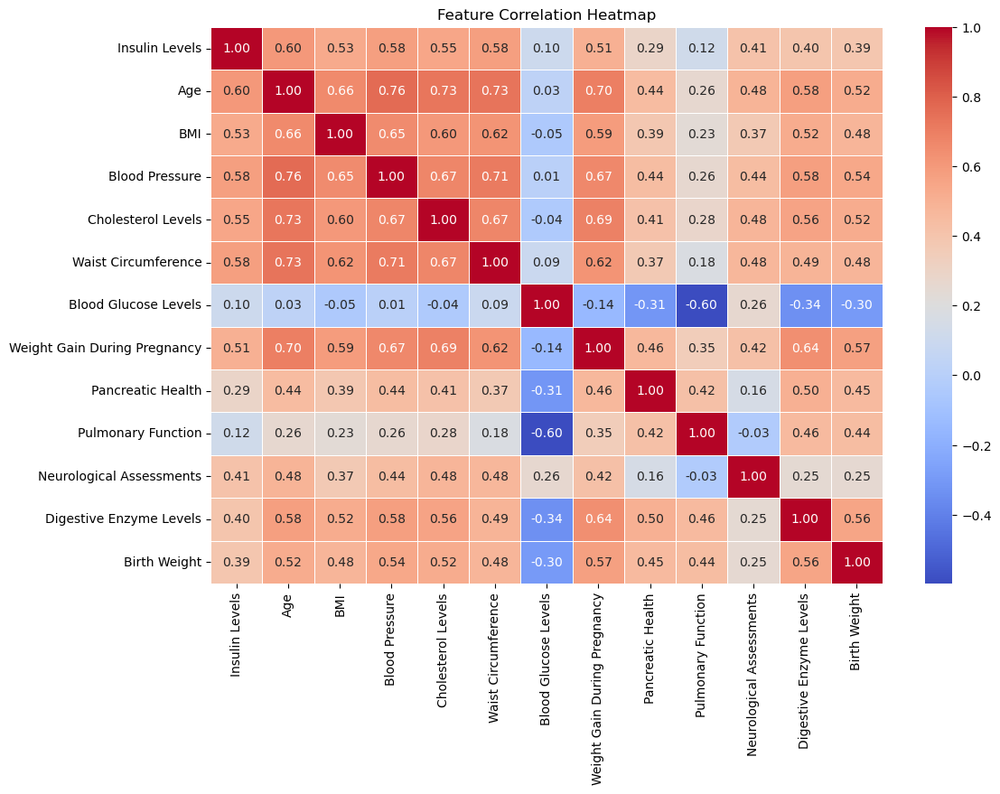

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt

# Compute correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(df.select_dtypes(include=['number']).corr(numeric_only=True), annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Feature Correlation Heatmap")
plt.show()


###  Distribution of Diabetes Cases



In [11]:
fig = px.pie(df, names="Target", title="Distribution of Diabetes Cases", hole=0.4,
              color_discrete_sequence=px.colors.qualitative.Set2)
fig.show()


###  Age Distribution by Diabetes Outcome


In [12]:
fig = px.histogram(df, x="Age", color="Target", barmode="overlay",
                    title="Age Distribution by Diabetes Outcome",
                    color_discrete_map={0: "blue", 1: "red"})
fig.show()


### Relationship Between Blood Glucose & Insulin Levels

In [13]:
fig = px.scatter(df, x="Blood Glucose Levels", y="Insulin Levels", color="Target",
                  title="Blood Glucose vs Insulin Levels", opacity=0.7)
fig.show()


### Average BMI by Diabetes Outcome

In [14]:
fig = px.bar(df.groupby("Target")["BMI"].mean().reset_index(), x="Target", y="BMI",
              title="Average BMI by Diabetes Outcome", color="Target")
fig.show()


### Box Plot for Blood Pressure by Diabetes Status

In [15]:
fig = px.box(df, x="Target", y="Blood Pressure", color="Target",
              title="Blood Pressure by Diabetes Status")
fig.show()


### Relationship Between Age and Cholesterol Levels

In [16]:
fig = px.scatter(df, x="Age", y="Cholesterol Levels", color="Target",
                   title="Age vs Cholesterol Levels", opacity=0.7)
fig.show()


## Model

### PCA

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Load the cleaned dataset
df = pd.read_csv("data/diabetes_cleaned.csv")

# Display the first 5 rows
df.head()

# Drop categorical columns (assuming object types are categorical)
df_numeric = df.select_dtypes(include=['float64', 'int64'])

# Display the new dataset
df_numeric.head()

# Normalize the numerical data
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_numeric)

# Convert back to DataFrame
df_scaled = pd.DataFrame(df_scaled, columns=df_numeric.columns)

# Display the first 5 rows of the scaled data
df_scaled.head()

,Insulin Levels,Age,BMI,Blood Pressure,Cholesterol Levels,Waist Circumference,Blood Glucose Levels,Weight Gain During Pregnancy,Pancreatic Health,Pulmonary Function,Neurological Assessments,Digestive Enzyme Levels,Birth Weight
0,1.709118,0.555017,2.197854,0.634773,0.137716,2.197183,0.151542,0.259896,-0.578659,0.479322,1.758207,0.494018,-0.655702
1,-0.798957,-1.180024,-1.294223,-1.922277,-1.658739,-1.624429,0.359175,-0.778199,-1.079046,-0.857855,-1.182325,-0.949955,-1.703567
2,0.501526,0.146772,-0.130197,0.484358,-0.221575,0.139392,-1.156546,-0.051533,0.422114,0.813616,-1.182325,0.442447,0.735381
3,-1.263416,-1.180024,-1.460513,-0.568545,-0.985068,-0.889503,-0.824333,-0.362961,0.071843,1.565777,0.287941,0.700299,0.623310
4,-0.427391,-1.180024,-1.294223,-0.418130,-1.097347,-0.301563,2.663900,-1.401056,-1.879665,-2.445751,-1.182325,-1.156237,-1.859066


In [47]:
# Apply PCA with 2 components
pca_2d = PCA(n_components=2)
pca_2d_result = pca_2d.fit_transform(df_scaled)

# Convert to DataFrame
df_pca_2d = pd.DataFrame(pca_2d_result, columns=["PC1", "PC2"])

# Display the first 5 rows
df_pca_2d.head()

,PC1,PC2
0,2.624146,1.643540
1,-4.379488,0.077015
2,0.647789,-1.699542
3,-1.332050,-2.271582
4,-4.061359,3.072116


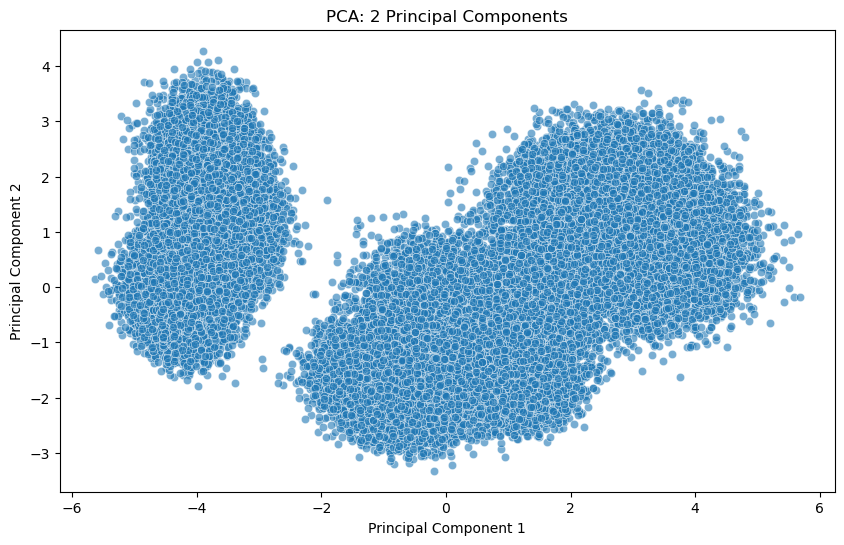

In [48]:
plt.figure(figsize=(10,6))
sns.scatterplot(x=df_pca_2d["PC1"], y=df_pca_2d["PC2"], alpha=0.6)
plt.title("PCA: 2 Principal Components")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

In [49]:
# Apply PCA with 3 components
pca_3d = PCA(n_components=3)
pca_3d_result = pca_3d.fit_transform(df_scaled)

# Convert to DataFrame
df_pca_3d = pd.DataFrame(pca_3d_result, columns=["PC1", "PC2", "PC3"])

# Display the first 5 rows
df_pca_3d.head()

,PC1,PC2,PC3
0,2.624150,1.643332,-0.140096
1,-4.379489,0.077119,-0.282175
2,0.647788,-1.699469,-0.900144
3,-1.332050,-2.271528,1.662848
4,-4.061359,3.072115,-1.282881


c:\Users\Rohan Jain\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



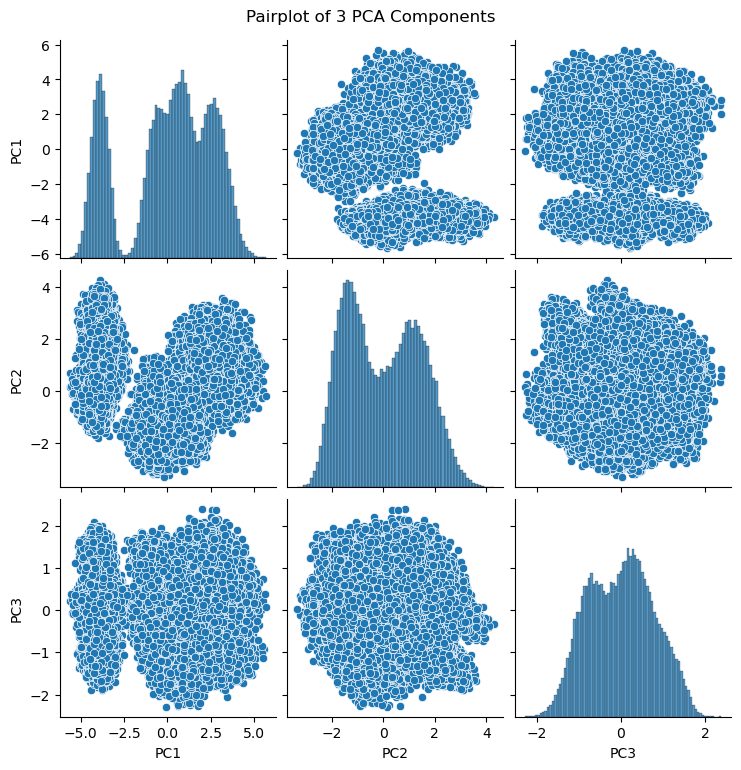

In [50]:
sns.pairplot(df_pca_3d)
plt.suptitle("Pairplot of 3 PCA Components", y=1.02)
plt.show()

In [51]:
# Percentage of variance explained
explained_variance_2d = np.sum(pca_2d.explained_variance_ratio_) * 100
explained_variance_3d = np.sum(pca_3d.explained_variance_ratio_) * 100

print(f"Variance retained in 2D PCA: {explained_variance_2d:.2f}%")
print(f"Variance retained in 3D PCA: {explained_variance_3d:.2f}%")

Variance retained in 2D PCA: 65.61%
Variance retained in 3D PCA: 70.30%


In [42]:
# Fit PCA with all components
pca_full = PCA()
pca_full.fit(df_scaled)

# Find the minimum number of components needed to retain 95% variance
explained_variance = np.cumsum(pca_full.explained_variance_ratio_)
num_components_95 = np.argmax(explained_variance >= 0.95) + 1

print(f"Number of components needed to retain 95% variance: {num_components_95}")

Number of components needed to retain 95% variance: 11


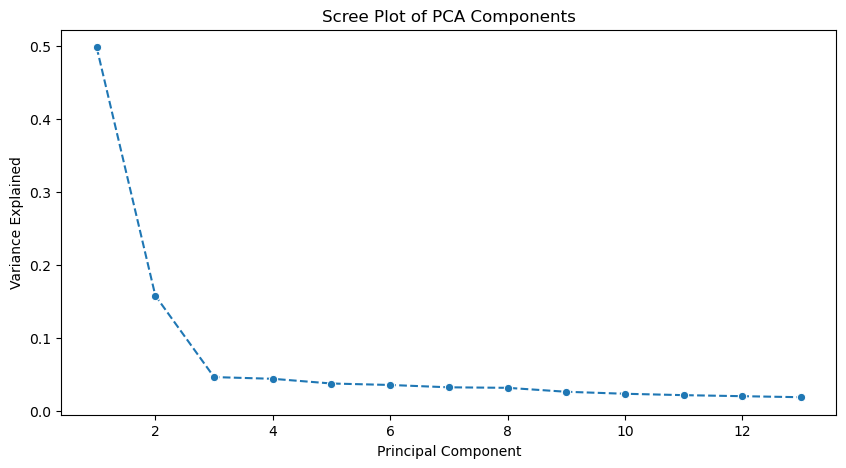

In [43]:
# Scree Plot
plt.figure(figsize=(10,5))
sns.lineplot(x=range(1, len(pca_full.explained_variance_ratio_)+1), 
             y=pca_full.explained_variance_ratio_, 
             marker='o', linestyle='--')
plt.xlabel("Principal Component")
plt.ylabel("Variance Explained")
plt.title("Scree Plot of PCA Components")
plt.show()

In [ ]:
# Extract and display the top 3 eigenvalues
top_3_eigenvalues = pca_full.explained_variance_[:3]
print("\nTop 3 Eigenvalues of the dataset:")
print(top_3_eigenvalues)


Top 3 Eigenvalues of the dataset:
[6.47232095 2.05658962 0.60963223]


### Clustering

##### K-Means

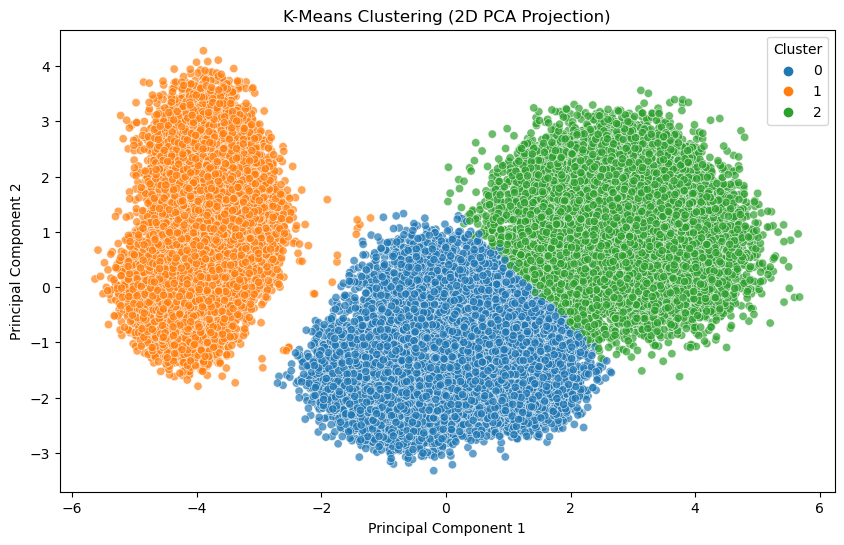

K-Means clustering completed successfully!


In [1]:
# Import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# **Load the Cleaned Dataset**
df = pd.read_csv("data/diabetes_cleaned.csv")  # Update with correct path if needed

# **Drop Non-Numeric Columns**
df_numeric = df.select_dtypes(include=['number'])

# *Standardize the Data**
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_numeric)

# *Apply K-Means Clustering**
k = 3  # Set the number of clusters (change as needed)
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
df["Cluster"] = kmeans.fit_predict(df_scaled)

# **🔹 Visualize Clusters Using PCA (2D Scatter Plot)**
pca = PCA(n_components=2)
df_pca = pca.fit_transform(df_scaled)
df_pca = pd.DataFrame(df_pca, columns=["PC1", "PC2"])
df_pca["Cluster"] = df["Cluster"]

plt.figure(figsize=(10, 6))
sns.scatterplot(x=df_pca["PC1"], y=df_pca["PC2"], hue=df_pca["Cluster"], palette="tab10", alpha=0.7)
plt.title("K-Means Clustering (2D PCA Projection)")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.legend(title="Cluster")
plt.show()

print("K-Means clustering completed successfully!")


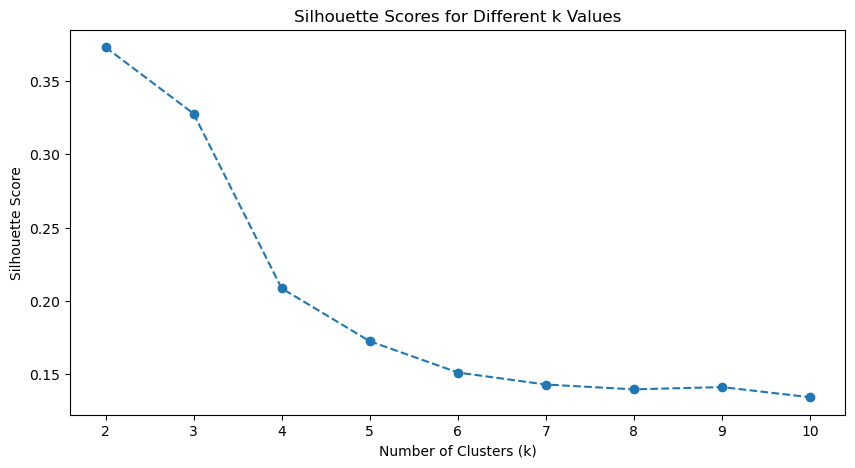

Selected 3 Optimal k Values: [2, 3, 4]


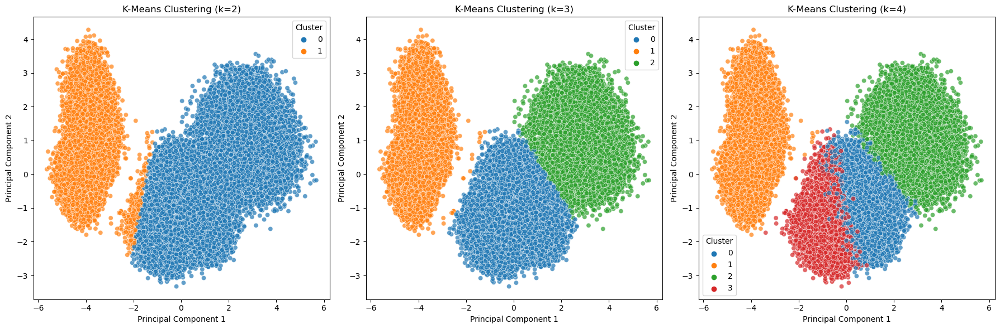

K-Means clustering completed successfully with different k values!


In [37]:
# Import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

# **Load the Cleaned Dataset**
df = pd.read_csv("data/diabetes_cleaned.csv")  # Update path if needed

# **Drop Non-Numeric Columns**
df_numeric = df.select_dtypes(include=['number'])

# *Standardize the Data**
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_numeric)

# **🔹 Find the Best k Using Silhouette Score**
silhouette_scores = []
k_range = range(2, 11)  # Checking k from 2 to 10 clusters

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    cluster_labels = kmeans.fit_predict(df_scaled)
    score = silhouette_score(df_scaled, cluster_labels)
    silhouette_scores.append(score)

# **Plot Silhouette Scores**
plt.figure(figsize=(10, 5))
plt.plot(k_range, silhouette_scores, marker='o', linestyle='--')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Scores for Different k Values")
plt.show()

# **Select Three Optimal k Values**
optimal_k_values = sorted(zip(k_range, silhouette_scores), key=lambda x: x[1], reverse=True)[:3]
optimal_k_values = [k for k, _ in optimal_k_values]  # Extract k values
print(f"Selected 3 Optimal k Values: {optimal_k_values}")

# **🔹 Perform K-Means Clustering with Selected k Values**
fig, axes = plt.subplots(1, 3, figsize=(18, 6))  # Creating three subplots for visualization

for i, k in enumerate(optimal_k_values):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    df["Cluster"] = kmeans.fit_predict(df_scaled)

    # **Apply PCA for Visualization**
    pca = PCA(n_components=2)
    df_pca = pca.fit_transform(df_scaled)
    df_pca = pd.DataFrame(df_pca, columns=["PC1", "PC2"])
    df_pca["Cluster"] = df["Cluster"]

    # **Scatter Plot of Clusters**
    sns.scatterplot(x=df_pca["PC1"], y=df_pca["PC2"], hue=df_pca["Cluster"], palette="tab10", alpha=0.7, ax=axes[i])
    axes[i].set_title(f"K-Means Clustering (k={k})")
    axes[i].set_xlabel("Principal Component 1")
    axes[i].set_ylabel("Principal Component 2")

plt.tight_layout()
plt.show()

print("K-Means clustering completed successfully with different k values!")


##### Hierarchical Clustering

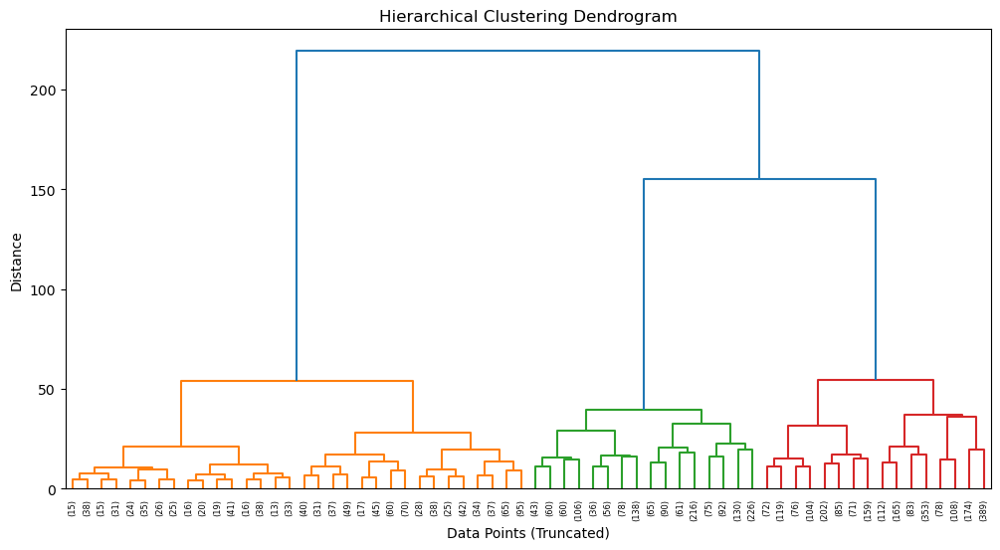

In [57]:
import numpy as np
import pandas as pd
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import linkage, dendrogram

# **Load and Scale Dataset**
df = pd.read_csv("data/diabetes_cleaned.csv")
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df.select_dtypes(include=[np.number]))

# **Step 5: Perform Hierarchical Clustering (Limited Sample to Prevent Crashing)**
subset_size = min(5000, len(scaled_data))  # Limit sample size to avoid memory issues
linkage_matrix = linkage(scaled_data[:subset_size], method='ward')  # Compute hierarchical clusters

# **Hierarchical Clustering Dendrogram (Using Limited Sample Size)**
plt.figure(figsize=(12, 6))  # Increase figure size for clarity
dendrogram(linkage_matrix, truncate_mode="level", p=5)  # Only last 5 merging steps shown
plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Data Points (Truncated)")
plt.ylabel("Distance")
plt.show()


In [25]:
from sklearn.cluster import KMeans

# Ensure K-Means has been applied
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
df["Cluster"] = kmeans.fit_predict(df_scaled)  # Assign cluster labels to df

# Ensure Hierarchical Clustering has been applied
if "Cluster_HC" not in df_pca_2d.columns:
    raise KeyError("The 'Cluster_HC' column is missing. Ensure Hierarchical clustering has been applied.")

print(df["Cluster"].head())  # Check if clusters are assigned


0    2
1    1
2    0
3    0
4    1
Name: Cluster, dtype: int32


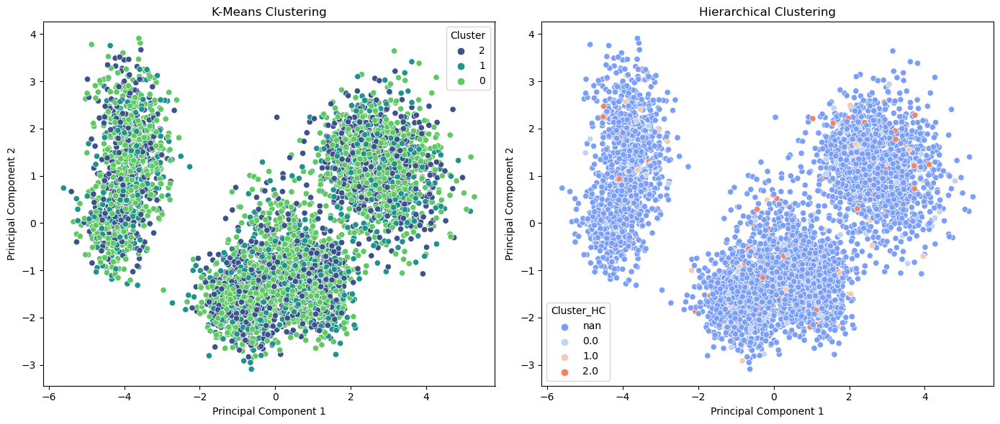

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create side-by-side visualization of K-Means vs Hierarchical Clustering
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# K-Means Clustering Visualization
sns.scatterplot(x=df_pca_2d["PC1"], y=df_pca_2d["PC2"], hue=df["Cluster"].astype(str), palette="viridis", ax=axes[0])
axes[0].set_title("K-Means Clustering")
axes[0].set_xlabel("Principal Component 1")
axes[0].set_ylabel("Principal Component 2")

# Hierarchical Clustering Visualization
sns.scatterplot(x=df_pca_2d["PC1"], y=df_pca_2d["PC2"], hue=df_pca_2d["Cluster_HC"].astype(str), palette="coolwarm", ax=axes[1])
axes[1].set_title("Hierarchical Clustering")
axes[1].set_xlabel("Principal Component 1")
axes[1].set_ylabel("Principal Component 2")

plt.tight_layout()
plt.show()


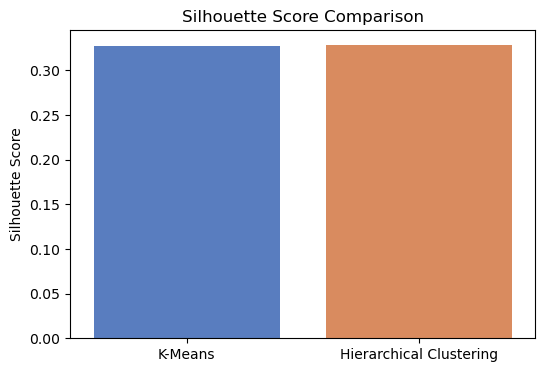

K-Means Silhouette Score: 0.3277
Hierarchical Clustering Silhouette Score: 0.3286


In [27]:
import seaborn as sns

# Compute Silhouette Scores for Both Methods
silhouette_kmeans = silhouette_score(df_scaled, df["Cluster"])
silhouette_hc = silhouette_score(df_sampled_scaled, df_sampled["Cluster_HC"])

# Store Scores in a Dictionary
silhouette_scores = {
    'K-Means': silhouette_kmeans,
    'Hierarchical Clustering': silhouette_hc
}

# Plot Silhouette Score Comparison
plt.figure(figsize=(6, 4))
sns.barplot(x=list(silhouette_scores.keys()), y=list(silhouette_scores.values()), palette="muted")
plt.title("Silhouette Score Comparison")
plt.ylabel("Silhouette Score")
plt.show()

# Print Silhouette Scores
print(f"K-Means Silhouette Score: {silhouette_kmeans:.4f}")
print(f"Hierarchical Clustering Silhouette Score: {silhouette_hc:.4f}")


#### **Comparison: Dendrogram vs. K-Means**

##### **Cluster Formation**
- K-Means forms well-separated, compact clusters.
- Hierarchical clustering (dendrogram) shows hierarchical relationships but has overlapping clusters.

##### **Interpretability**
- K-Means is easier to interpret and adjust.
- Hierarchical clustering provides a detailed dendrogram but is harder to modify once clusters are formed.

##### **Performance**
- K-Means is **faster** and more **scalable** for large datasets.
- Hierarchical clustering is **computationally expensive** for large datasets.

##### **Silhouette Score Comparison**
- **K-Means Silhouette Score:** **0.3277**
- **Hierarchical Clustering Silhouette Score:** **0.3286**

##### **Conclusion**
- **K-Means is preferred** for large datasets due to efficiency.
- **Hierarchical clustering is useful** when analyzing cluster relationships and structures.


#### DBSCAN

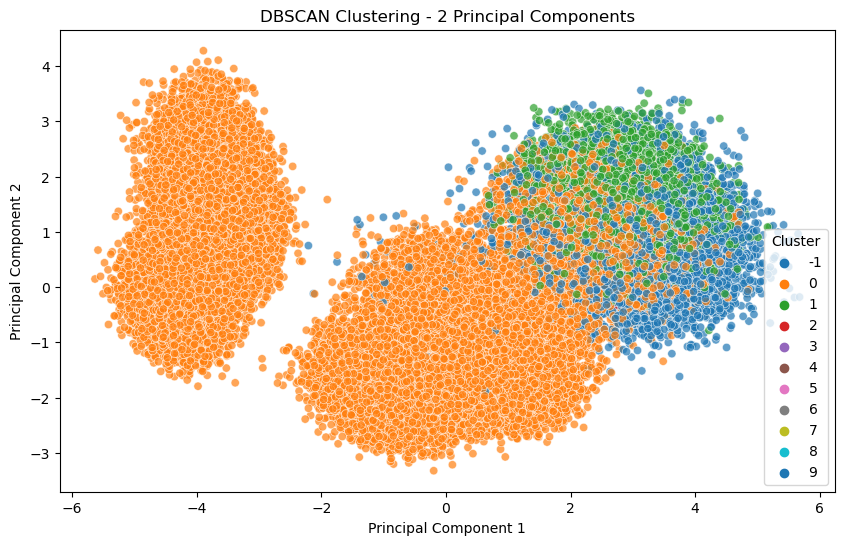

DBSCAN Silhouette Score: 0.0024


In [28]:
# Import necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

# Load dataset
df = pd.read_csv("data/diabetes_cleaned.csv")

# Select numerical columns and scale the data
df_numeric = df.select_dtypes(include=[np.number])
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_numeric)

# Apply DBSCAN Clustering
dbscan = DBSCAN(eps=1.5, min_samples=10)  # Adjust eps and min_samples based on trial
df["Cluster_DBSCAN"] = dbscan.fit_predict(df_scaled)

# Apply PCA for visualization (2 components)
pca = PCA(n_components=2)
df_pca_2d = pd.DataFrame(pca.fit_transform(df_scaled), columns=["PC1", "PC2"])
df_pca_2d["Cluster_DBSCAN"] = df["Cluster_DBSCAN"]

# Plot DBSCAN Clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df_pca_2d["PC1"], y=df_pca_2d["PC2"], hue=df_pca_2d["Cluster_DBSCAN"], palette="tab10", alpha=0.7)
plt.title("DBSCAN Clustering - 2 Principal Components")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.legend(title="Cluster")
plt.show()

# Compute Silhouette Score (Ignoring noise points labeled as -1)
if len(set(df["Cluster_DBSCAN"])) > 1:  # Ensure at least 2 clusters exist
    dbscan_silhouette = silhouette_score(df_scaled[df["Cluster_DBSCAN"] != -1], df["Cluster_DBSCAN"][df["Cluster_DBSCAN"] != -1])
    print(f"DBSCAN Silhouette Score: {dbscan_silhouette:.4f}")
else:
    print("DBSCAN did not form enough clusters for silhouette score calculation.")


### **Comparison of DBSCAN with K-Means & Hierarchical Clustering**  

1. **Cluster Shape:**  
   - DBSCAN detects **arbitrarily shaped** clusters, unlike K-Means which assumes **spherical clusters**.  
   - Hierarchical clustering also assumes some structure but struggles with large datasets.

2. **Noise & Outliers:**  
   - DBSCAN identifies **outliers** (labeled as `-1`), whereas **K-Means and Hierarchical force all points** into clusters.

3. **Silhouette Score:**  
   - **Lower for DBSCAN (0.0024)** than K-Means & Hierarchical (~0.32), indicating **less defined clusters**.  
   - This suggests **DBSCAN struggled with parameter tuning (eps & min_samples).**  

4. **Performance:**  
   - **K-Means** is **fastest**, **Hierarchical** is slow for large data, **DBSCAN** is **moderate** but requires tuning.  

5. **Best Use Case:**  
   - **DBSCAN works well for non-spherical clusters & noise detection** but may not perform well if clusters have **varied densities**, as seen in this dataset.

### **Final Verdict:**  
- **K-Means performed best in terms of silhouette score and cluster separation.**  
- **DBSCAN is useful for detecting noise but struggled with this dataset's density variations.**  
- **Hierarchical gives a good hierarchy view but is computationally expensive for large data.**


### ARM

In [29]:
import pandas as pd

# Load your dataset
df = pd.read_csv("data/diabetes_cleaned.csv")

# Display a preview
print(df.head())


                             Target Genetic Markers Autoantibodies  \
0          Steroid-Induced Diabetes        Positive       Negative   
1  Neonatal Diabetes Mellitus (NDM)        Positive       Negative   
2                       Prediabetic        Positive       Positive   
3                   Type 1 Diabetes        Negative       Positive   
4                  Wolfram Syndrome        Negative       Negative   

  Family History Environmental Factors  Insulin Levels  Age   BMI  \
0             No               Present            40.0   44  38.0   
1             No               Present            13.0   10  17.0   
2            Yes               Present            27.0   36  24.0   
3             No               Present             8.0   10  16.0   
4            Yes               Present            17.0   10  17.0   

  Physical Activity Dietary Habits  ...  Pulmonary Function  \
0              High        Healthy  ...                  76   
1              High        Healthy  ..

In [31]:
import pandas as pd
from mlxtend.frequent_patterns import apriori, association_rules

# Load dataset
df = pd.read_csv("data/diabetes_cleaned.csv")  # Update path if needed

# Convert categorical columns to string and create transactions
df = df.astype(str)

# Convert each row into a list of items
transactions = df.apply(lambda x: list(x.dropna().unique()), axis=1).tolist()

# Print sample transactions
print("Sample Transactions (First 5 Rows):")
for i, transaction in enumerate(transactions[:5]):
    print(f"Transaction {i+1}: {transaction}")


Sample Transactions (First 5 Rows):
Transaction 1: ['Steroid-Induced Diabetes', 'Positive', 'Negative', 'No', 'Present', '40.0', '44', '38.0', 'High', 'Healthy', '124', '201', '50', '168.0', 'Low Risk', 'Medium', 'Smoker', 'Normal', '18', '36', '76', '3', '56', 'Ketones Present', '2629']
Transaction 2: ['Neonatal Diabetes Mellitus (NDM)', 'Positive', 'Negative', 'No', 'Present', '13.0', '10', '17.0', 'High', 'Healthy', '73', '121', '24', '178.0', 'Low Risk', 'Non-Smoker', 'Moderate', 'Normal', 'Yes', '8', '26', '60', '1', '28', 'Glucose Present', '1881']
Transaction 3: ['Prediabetic', 'Positive', 'Yes', 'Present', '27.0', '36', '24.0', 'High', 'Unhealthy', '121', '185', '105.0', 'Low Risk', 'Medium', 'Smoker', 'Abnormal', 'No', 'Normal', '15', '56', '80', 'Negative', '1', '55', 'Ketones Present', '3622']
Transaction 4: ['Type 1 Diabetes', 'Negative', 'Positive', 'No', 'Present', '8.0', '10', '16.0', 'Low', 'Unhealthy', '100', '151', '29', '121.0', 'Low Risk', 'High', 'Smoker', 'Moderat

In [36]:
import pandas as pd
from mlxtend.frequent_patterns import apriori, association_rules
from mlxtend.preprocessing import TransactionEncoder

# **Load Dataset**
df = pd.read_csv("data/diabetes_cleaned.csv")  # Update path if needed

# **Convert Dataset to Transaction Format**
df = df.astype(str)  # Convert all values to string for transaction processing
transactions = df.apply(lambda x: list(x.dropna().unique()), axis=1).tolist()

# **Reduce Data Size to Prevent MemoryError**
sample_size = min(15000, len(transactions))  # Take a subset if the dataset is too large
transactions_sampled = transactions[:sample_size]

# **Encode Transactions**
te = TransactionEncoder()
te_ary = te.fit(transactions_sampled).transform(transactions_sampled, sparse=True)  # Use sparse matrix to save memory
df_encoded = pd.DataFrame.sparse.from_spmatrix(te_ary, columns=te.columns_)

# **Apply Apriori with Higher min_support to Reduce Memory Load**
frequent_itemsets = apriori(df_encoded, min_support=0.1, use_colnames=True)  # Adjust min_support as needed

# **Generate Association Rules (Filtered by Lift)**
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1.2)

# **Function to Display Results as Table**
def display_rules(title, rules_df, sort_by, top_n=15):
    print(f"\n{title} (Top {top_n})\n")
    styled_table = rules_df.sort_values(by=sort_by, ascending=False).head(top_n)
    display(styled_table)  # Works in Jupyter Notebook / Google Colab

# **Display Top 15 Rules in Table Format**
display_rules("Top 15 Rules by Support", rules, "support")
display_rules("Top 15 Rules by Confidence", rules, "confidence")
display_rules("Top 15 Rules by Lift", rules, "lift")



Top 15 Rules by Support (Top 15)



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(1),(10),0.370200,0.217067,0.123267,0.332973,1.533967,0.042909,1.173766,0.552708
1,(10),(1),0.217067,0.370200,0.123267,0.567875,1.533967,0.042909,1.457448,0.444604
18,"(1, Yes)",(10),0.363933,0.217067,0.121533,0.333944,1.538440,0.042536,1.175477,0.550242
20,(1),"(10, Yes)",0.370200,0.213933,0.121533,0.328291,1.534548,0.042335,1.170249,0.553100
21,(10),"(1, Yes)",0.217067,0.363933,0.121533,0.559889,1.538440,0.042536,1.445243,0.447025
19,"(10, Yes)",(1),0.213933,0.370200,0.121533,0.568090,1.534548,0.042335,1.458173,0.443146
6,"(No, 1)",(10),0.365200,0.217067,0.121400,0.332421,1.531422,0.042127,1.172794,0.546648
7,"(No, 10)",(1),0.213533,0.370200,0.121400,0.568530,1.535736,0.042350,1.459659,0.443562
9,(10),"(No, 1)",0.217067,0.365200,0.121400,0.559275,1.531422,0.042127,1.440355,0.443220
8,(1),"(No, 10)",0.370200,0.213533,0.121400,0.327931,1.535736,0.042350,1.170217,0.553900



Top 15 Rules by Confidence (Top 15)



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
31,"(Normal, 10, Negative)",(1),0.175200,0.3702,0.100133,0.571537,1.543861,0.035274,1.469906,0.427101
87,"(No, 10, Negative, Yes)",(1),0.184933,0.3702,0.105600,0.571017,1.542454,0.037138,1.468122,0.431477
103,"(No, Normal, 10, Yes)",(1),0.193400,0.3702,0.110400,0.570838,1.541971,0.038803,1.467510,0.435754
39,"(10, Negative, Yes)",(1),0.188067,0.3702,0.107333,0.570720,1.541652,0.037711,1.467106,0.432727
23,"(No, 10, Negative)",(1),0.187733,0.3702,0.107133,0.570668,1.541512,0.037634,1.466929,0.432476
47,"(No, Normal, 10)",(1),0.196333,0.3702,0.112000,0.570458,1.540947,0.039317,1.466214,0.436808
3,"(10, Negative)",(1),0.190867,0.3702,0.108867,0.570381,1.540737,0.038208,1.465949,0.433748
71,"(Normal, 10, Yes)",(1),0.196533,0.3702,0.112067,0.570217,1.540295,0.039310,1.465391,0.436575
11,"(Normal, 10)",(1),0.199467,0.3702,0.113667,0.569853,1.539311,0.039824,1.464150,0.437657
63,"(No, 10, Yes)",(1),0.210400,0.3702,0.119667,0.568758,1.536353,0.041777,1.460433,0.442133



Top 15 Rules by Lift (Top 15)



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
105,"(Normal, 1, Yes)","(No, 10)",0.332667,0.213533,0.110400,0.331864,1.554154,0.039365,1.177105,0.534310
114,"(No, 10)","(Normal, 1, Yes)",0.213533,0.332667,0.110400,0.517015,1.554154,0.039365,1.381686,0.453374
77,(10),"(Normal, 1, Yes)",0.217067,0.332667,0.112067,0.516278,1.551937,0.039856,1.379579,0.454245
70,"(Normal, 1, Yes)",(10),0.332667,0.217067,0.112067,0.336874,1.551937,0.039856,1.180670,0.532933
30,"(Normal, 1, Negative)",(10),0.297467,0.217067,0.100133,0.336620,1.550769,0.035563,1.180219,0.505540
37,(10),"(Normal, 1, Negative)",0.217067,0.297467,0.100133,0.461302,1.550769,0.035563,1.304133,0.453626
110,"(Normal, 1)","(No, 10, Yes)",0.338600,0.210400,0.110400,0.326048,1.549660,0.039159,1.171598,0.536282
109,"(No, 10, Yes)","(Normal, 1)",0.210400,0.338600,0.110400,0.524715,1.549660,0.039159,1.391586,0.449211
35,"(10, Negative)","(Normal, 1)",0.190867,0.338600,0.100133,0.524625,1.549393,0.035506,1.391321,0.438229
32,"(Normal, 1)","(10, Negative)",0.338600,0.190867,0.100133,0.295728,1.549393,0.035506,1.148892,0.536114
